In [ ]:
!pip install tensorflow_addons

     |████████████████████████████████| 679 kB 8.5 MB/s 


In [ ]:
!nvidia-smi

Fri Jul 23 10:37:11 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   70C    P0    32W /  70W |    732MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt
plt.style.use('ggplot')
from tensorflow import keras
from tensorflow.keras import layers
import seaborn as sns
import pandas as pd
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.initializers import RandomNormal
import tensorflow_datasets as tfds

from tensorflow.keras.layers import Conv2D, LeakyReLU, Input, Activation, Conv2DTranspose, Concatenate
from tensorflow_addons.layers import InstanceNormalization

from tensorflow.keras.models import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.losses import BinaryCrossentropy

# Hyper Parameters

In [ ]:
img_rows, img_cols, channels = 256, 256, 3
weight_initializer = RandomNormal(stddev=0.02)
gen_g_optimizer = gen_f_optimizer = Adam(learning_rate=0.0002, beta_1=0.5)
dis_x_optimizer = dis_y_optimizer = Adam(learning_rate=0.0002, beta_1=0.5)

epochs = 10
LAMBDA = 10

# Dataset

In [ ]:
data, metadata = tfds.load('cycle_gan/monet2photo', with_info=True, as_supervised=True)
train_x, train_y, test_x, test_y = data['trainA'], data['trainB'], data['testA'], data['testB']


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/monet2photo/2.0.0.incompleteH6EDKP/cycle_gan-trainA.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/monet2photo/2.0.0.incompleteH6EDKP/cycle_gan-trainB.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/monet2photo/2.0.0.incompleteH6EDKP/cycle_gan-testA.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/monet2photo/2.0.0.incompleteH6EDKP/cycle_gan-testB.tfrecord


Dataset cycle_gan downloaded and prepared to /root/tensorflow_datasets/cycle_gan/monet2photo/2.0.0. Subsequent calls will reuse this data.


In [ ]:
def preprocess_image(image, _):
    return tf.reshape(tf.cast(tf.image.resize(image, (int(img_rows), int(img_cols))), tf.float32) / 127.5 - 1, (1, img_rows, img_cols, channels))


In [ ]:
train_x = train_x.map(preprocess_image)
train_y = train_y.map(preprocess_image)
test_x = test_x.map(preprocess_image)
test_y = test_y.map(preprocess_image)

# Networks


## Residual

In [ ]:
def __residual_block(x, kernel_size):
  y = layers.Conv2D(kernel_size, (3, 3), padding='same')(x)
  y = InstanceNormalization(axis=-1)(y)
  y = layers.ReLU()(y)
  y = layers.Conv2D(kernel_size, (3, 3), padding='same')(y)
  y = InstanceNormalization(axis=-1)(y)
  out = layers.Concatenate()([y, x])
  return out

def __ck(x, kernel_size, use_instancenorm=True):
    y = layers.Conv2D(kernel_size, (7, 7), strides=1, padding='same', kernel_initializer=weight_initializer)(x)
    if use_instancenorm:
        y = InstanceNormalization(axis=-1)(y)
    out = layers.ReLU()(y)
    return out

def __dk(x, kernel_size, use_instancenorm=True):
    y = layers.Conv2D(kernel_size, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer)(x)
    if use_instancenorm:
        y = InstanceNormalization(axis=-1)(y)
    out = layers.ReLU()(y)
    return out

def __uk(x, kernel_size):
    y = layers.Conv2DTranspose(kernel_size, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer)(x)
    y = InstanceNormalization(axis=-1)(y)
    out = layers.ReLU()(y)
    return out

def __out(x):
    y = layers.Conv2DTranspose(3, (7, 7), strides=1, padding='same', kernel_initializer=weight_initializer)(x)
    y = InstanceNormalization(axis=-1)(y)
    out = layers.Activation("tanh")(y)
    return out


def create_generator(name=""):
    x = layers.Input(shape=(img_rows, img_cols, channels))
    y = __ck(x, 64)
    y = __dk(y, 128)
    y = __dk(y, 256)
    y = __residual_block(y, 256)
    y = __residual_block(y, 256)
    y = __residual_block(y, 256)
    y = __residual_block(y, 256)
    y = __residual_block(y, 256)
    y = __residual_block(y, 256)
    y = __residual_block(y, 256)
    y = __residual_block(y, 256)
    y = __residual_block(y, 256)
    y = __uk(y, 128)
    y = __uk(y, 64)
    y = __out(y)

    generator = Model(x, y, name=name)
    return generator

## UNET


In [ ]:
def _dk(k, use_instancenorm=True):
    block = Sequential()
    block.add(Conv2D(k, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer))
    if use_instancenorm:
        block.add(InstanceNormalization(axis=-1))
    block.add(Activation('relu'))

    return block


def _uk(k):
    block = Sequential()
    block.add(Conv2DTranspose(k, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer))
    block.add(InstanceNormalization(axis=-1))
    block.add(Activation('relu'))

    return block

def create_generator(name=""):
    gen_input = Input(shape=(img_rows, img_cols, channels))

    encoder_layers = [
        _dk(64, False),
        _dk(128),
        _dk(256),
        _dk(512),
        _dk(512),
        _dk(512),
        _dk(512),
        _dk(512)
    ]

    decoder_layers = [
        _uk(512),
        _uk(512),
        _uk(512),
        _uk(512),
        _uk(256),
        _uk(128),
        _uk(64)
    ]

    gen = gen_input

    skips = []
    for layer in encoder_layers:
        gen = layer(gen)
        skips.append(gen)

    skips = skips[::-1][1:]

    for skip_layer, layer in zip(skips, decoder_layers):
        gen = layer(gen)
        gen = Concatenate()([gen, skip_layer])

    gen = Conv2DTranspose(channels, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer, activation='tanh')(gen)

    return Model(gen_input, gen, name=name)

## Discriminator


In [ ]:
def _ck(x, kernel_size, use_instancenorm=True):
    y = layers.Conv2D(kernel_size, (4, 4), strides=2, padding='same', kernel_initializer=weight_initializer)(x)
    if use_instancenorm:
        y = InstanceNormalization(axis=-1)(y)
    out = LeakyReLU(0.2)(y)
    return out

def create_discriminator(name=""):
    x = Input(shape=(img_rows, img_cols, channels))
    y = _ck(x, 64, False)
    y = _ck(y, 128)
    y = _ck(y, 256)
    y = _ck(y, 512)

    y = Conv2D(1, (4, 4), padding='same', kernel_initializer=weight_initializer)(y)
    
    dis = Model(x, y, name=name)
    dis.compile(loss='mse', optimizer=dis_x_optimizer)
    return dis

## Building networks


In [ ]:
generator_g = create_generator("G")
generator_f = create_generator("F")

discriminator_x = create_discriminator("Dx")
discriminator_y = create_discriminator("Dy")

In [ ]:
discriminator_x.summary()

Model: "Dx"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_27 (InputLayer)        [(None, 256, 256, 3)]     0         
_________________________________________________________________
conv2d_189 (Conv2D)          (None, 128, 128, 64)      3136      
_________________________________________________________________
leaky_re_lu_40 (LeakyReLU)   (None, 128, 128, 64)      0         
_________________________________________________________________
conv2d_190 (Conv2D)          (None, 64, 64, 128)       131200    
_________________________________________________________________
instance_normalization_232 ( (None, 64, 64, 128)       256       
_________________________________________________________________
leaky_re_lu_41 (LeakyReLU)   (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_191 (Conv2D)          (None, 32, 32, 256)       524544   

## Prepare train module

In [ ]:
loss = BinaryCrossentropy(from_logits=True)

def discriminator_loss(real, generated):
    return (loss(tf.ones_like(real), real) + loss(tf.zeros_like(generated), generated)) * 0.5

def gen_loss(validity):
    return loss(tf.ones_like(validity), validity)

def image_similarity(image1, image2):
    return tf.reduce_mean(tf.abs(image1 - image2))

In [ ]:
dis_y_loss_tracker1 = keras.metrics.Mean(name="discriminator loss y")
dis_x_loss_tracker1 = keras.metrics.Mean(name="discriminator loss x")
gen_g_loss_tracker1 = keras.metrics.Mean(name="generative loss g")
gen_f_loss_tracker1 = keras.metrics.Mean(name="generative loss f")


cyc_x_loss_tracker1 = keras.metrics.Mean(name="cyclic loss x")
cyc_y_loss_tracker1 = keras.metrics.Mean(name="cyclic loss y")

id_x_loss_tracker1 = keras.metrics.Mean(name="identity loss x")
id_y_loss_tracker1 = keras.metrics.Mean(name="identity loss y")


dis_y_loss_tracker = []
dis_x_loss_tracker = []
gen_g_loss_tracker = []
gen_f_loss_tracker = []

cyc_x_loss_tracker = []
cyc_y_loss_tracker = []

id_x_loss_tracker = []
id_y_loss_tracker = []

In [ ]:
@tf.function
def step(real_x, real_y):
    with tf.GradientTape(persistent=True) as tape:
        fake_y = generator_g(real_x, training=True)
        gen_g_validity = discriminator_y(fake_y, training=True)
        dis_y_loss = discriminator_loss(discriminator_y(real_y, training=True), gen_g_validity)

        with tape.stop_recording():
            discriminator_y_gradients = tape.gradient(dis_y_loss, discriminator_y.trainable_variables)
            dis_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

        fake_x = generator_f(real_y, training=True)
        gen_f_validity = discriminator_x(fake_x, training=True)
        dis_x_loss = discriminator_loss(discriminator_x(real_x, training=True), gen_f_validity)

        with tape.stop_recording():
            discriminator_x_gradients = tape.gradient(dis_x_loss, discriminator_x.trainable_variables)
            dis_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))

        dis_x_loss_tracker1.update_state(dis_x_loss)
        dis_y_loss_tracker1.update_state(dis_y_loss)
        
        gen_g_adv_loss = gen_loss(gen_g_validity)
        gen_f_adv_loss = gen_loss(gen_f_validity)

        gen_g_loss_tracker1.update_state(gen_g_adv_loss)
        gen_f_loss_tracker1.update_state(gen_f_adv_loss)

        cyc_x = generator_f(fake_y, training=True)
        cyc_x_loss = image_similarity(real_x, cyc_x)
        cyc_x_loss_tracker1.update_state(cyc_x_loss)

        cyc_y = generator_g(fake_x, training=True)
        cyc_y_loss =  image_similarity(real_y, cyc_y)
        cyc_y_loss_tracker1.update_state(cyc_y_loss)

        
        id_x = generator_f(real_x, training=True)
        id_x_loss = image_similarity(real_x, id_x)
        id_x_loss_tracker1.update_state(id_x_loss)

        id_y = generator_g(real_y, training=True)
        id_y_loss = image_similarity(real_y, id_y)
        id_y_loss_tracker1.update_state(id_y_loss)

        gen_g_loss = gen_g_adv_loss + (cyc_x_loss + cyc_y_loss) * LAMBDA + id_y_loss * 0.5*LAMBDA
        gen_f_loss = gen_f_adv_loss + (cyc_x_loss + cyc_y_loss) * LAMBDA + id_x_loss * 0.5*LAMBDA

        with tape.stop_recording():
            generator_g_gradients = tape.gradient(gen_g_loss, generator_g.trainable_variables)
            gen_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))

            generator_f_gradients = tape.gradient(gen_f_loss, generator_f.trainable_variables)
            gen_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    

    return {
        'dis_y':dis_y_loss_tracker1.result(),
        'dis_x':dis_x_loss_tracker1.result(), 
        'gen_g':gen_g_loss_tracker1.result(),
        'gen_f':gen_f_loss_tracker1.result(),
        'cyc_x':cyc_x_loss_tracker1.result(),
        'cyc_y':cyc_y_loss_tracker1.result(),
        'id_x':id_x_loss_tracker1.result(),
        'id_y':id_y_loss_tracker1.result()
    }

## Intermediate checking

In [ ]:
def generate_images():
    # Sample images
    x = next(iter(test_x.shuffle(1000))).numpy()
    y = next(iter(test_y.shuffle(1000))).numpy()
    
    y_hat = generator_g.predict(x.reshape((1, img_rows, img_cols, channels)))
    x_hat = generator_f.predict(y.reshape((1, img_rows, img_cols, channels)))
    
    plt.figure(figsize=(12, 12))

    images = [x[0], y_hat[0], y[0], x_hat[0]]

    for i in range(4):
        plt.subplot(2, 2, i+1)
        plt.imshow(images[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

## Train

In [ ]:
import time
for epoch in range(epochs):
    print('Epoch: {}'.format(epoch))
    start = time.time()

    for k, (real_x, real_y) in enumerate(tf.data.Dataset.zip((train_x, train_y))):
        if k % 50 == 0: print(k)
        history = step(tf.reshape(real_x, (1, img_rows, img_cols, channels)), tf.reshape(real_y, (1, img_rows, img_cols, channels)))
        dis_y_loss_tracker.append(np.array([history['dis_y']])[0])
        dis_x_loss_tracker.append(np.array([history['dis_x']])[0])
        gen_g_loss_tracker.append(np.array([history['gen_g']])[0])
        gen_f_loss_tracker.append(np.array([history['gen_f']])[0])

        cyc_x_loss_tracker.append(np.array([history['cyc_x']])[0])
        cyc_y_loss_tracker.append(np.array([history['cyc_y']])[0])

        id_x_loss_tracker.append(np.array([history['id_x']])[0])
        id_y_loss_tracker.append(np.array([history['id_y']])[0])
    generate_images()
    print('Time taken: {}'.format(time.time() - start))

Text(0.5, 1.0, 'identity y loss')

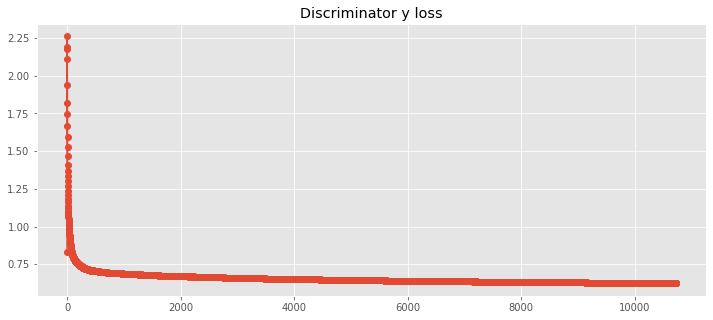

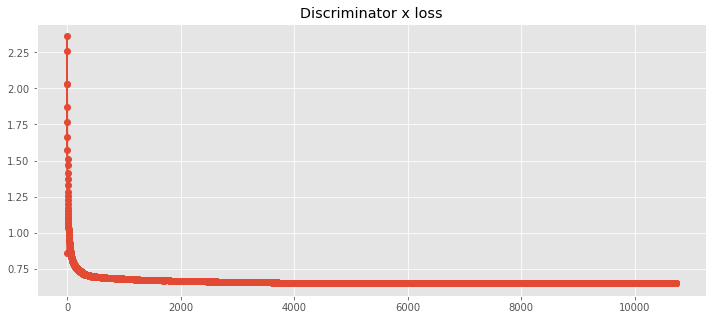

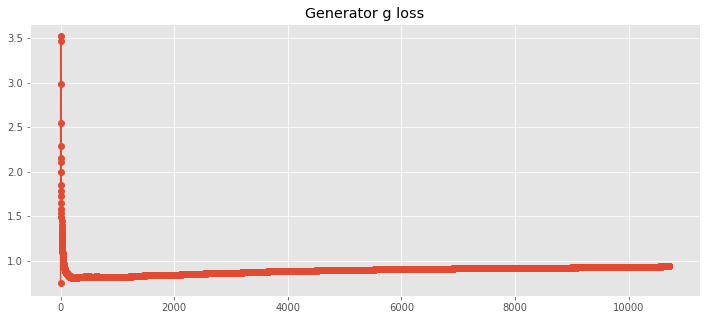

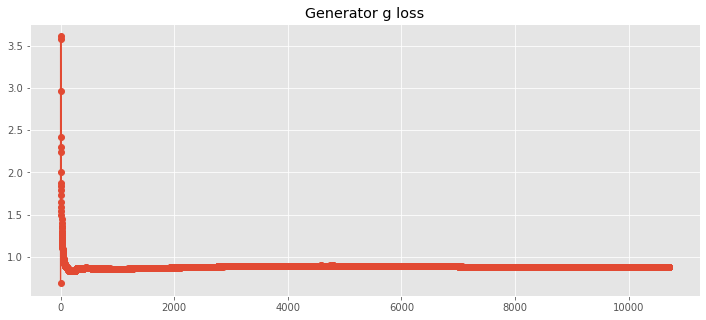

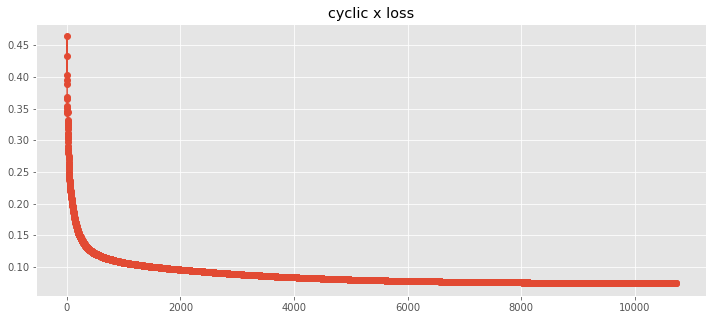

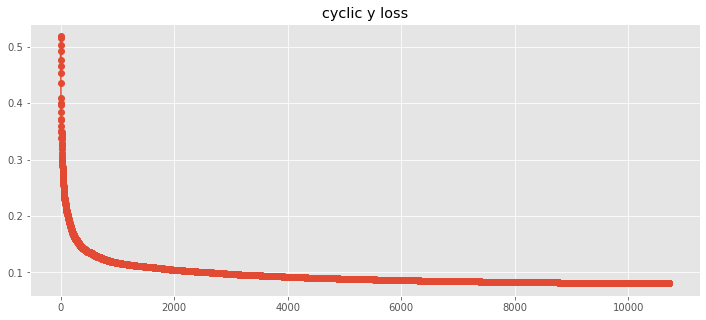

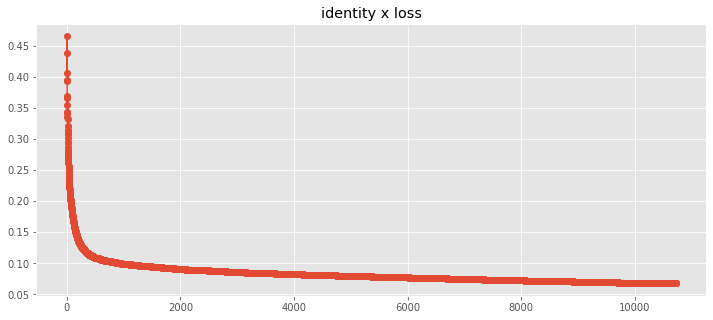

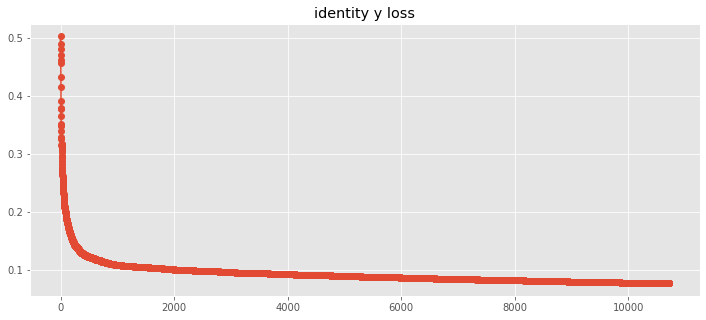

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(np.array(dis_y_loss_tracker), '-o')
plt.title('Discriminator y loss')
plt.figure(figsize=(12, 5))
plt.plot(dis_x_loss_tracker, '-o')
plt.title('Discriminator x loss')
plt.figure(figsize=(12, 5))
plt.plot(gen_g_loss_tracker, '-o')
plt.title('Generator g loss')
plt.figure(figsize=(12, 5))
plt.plot(gen_f_loss_tracker, '-o')
plt.title('Generator g loss')
plt.figure(figsize=(12, 5))
plt.plot(cyc_x_loss_tracker, '-o')
plt.title('cyclic x loss')
plt.figure(figsize=(12, 5))
plt.plot(cyc_y_loss_tracker, '-o')
plt.title('cyclic y loss')
plt.figure(figsize=(12, 5))
plt.plot(id_x_loss_tracker, '-o')
plt.title('identity x loss')
plt.figure(figsize=(12, 5))
plt.plot(id_y_loss_tracker, '-o')
plt.title('identity y loss')

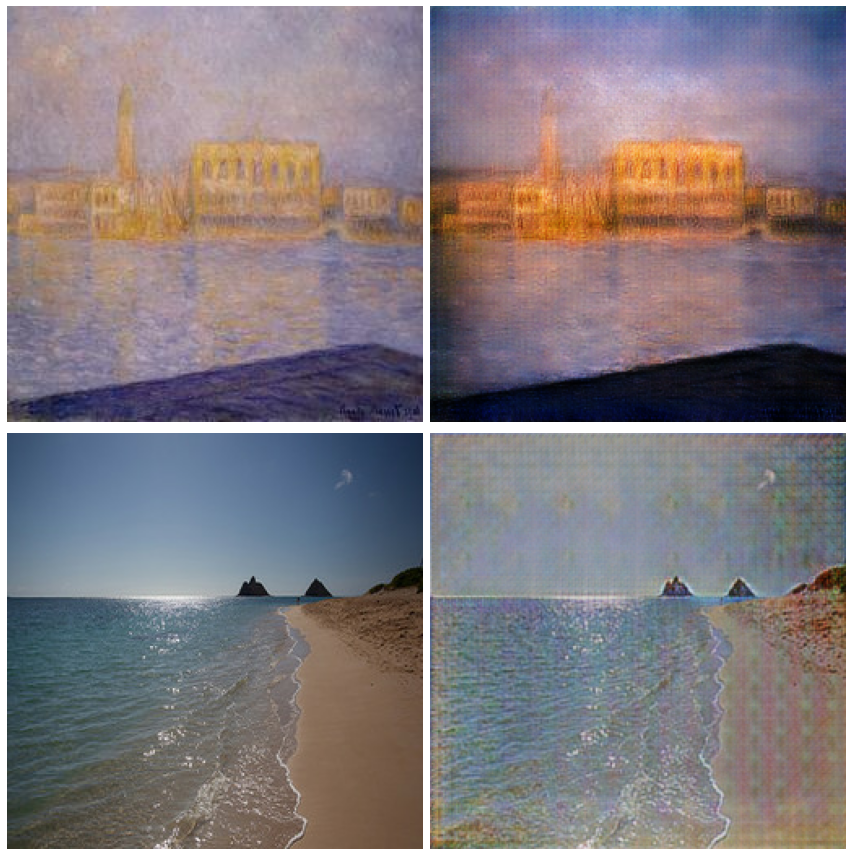

In [ ]:
x = next(iter(test_x.shuffle(1000))).numpy()
y = next(iter(test_y.shuffle(1000))).numpy()

x_hat = generator_f.predict(y.reshape((1, img_rows, img_cols, channels)))
y_hat = generator_g.predict(x_hat)

plt.figure(figsize=(12, 12))

images = [y[0], x_hat[0], y_hat[0]]

for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.imshow(images[i] * 0.5 + 0.5)
    plt.axis('off')
plt.tight_layout()
plt.show()

y_hat = generator_f.predict(x.reshape((1, img_rows, img_cols, channels)))
x_hat = generator_g.predict(y_hat)

plt.figure(figsize=(12, 12))

images = [x[0], y_hat[0], x_hat[0]]

for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.imshow(images[i] * 0.5 + 0.5)
    plt.axis('off')
plt.tight_layout()
plt.show()

Epoch: 0
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


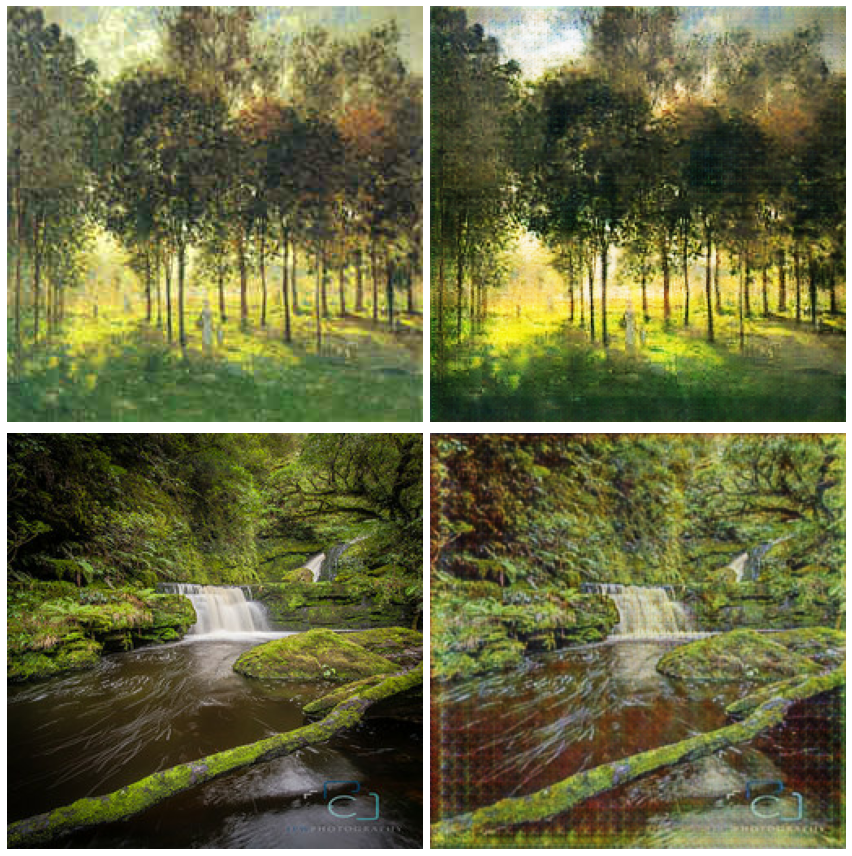

Time taken: 252.96168899536133
Epoch: 1
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


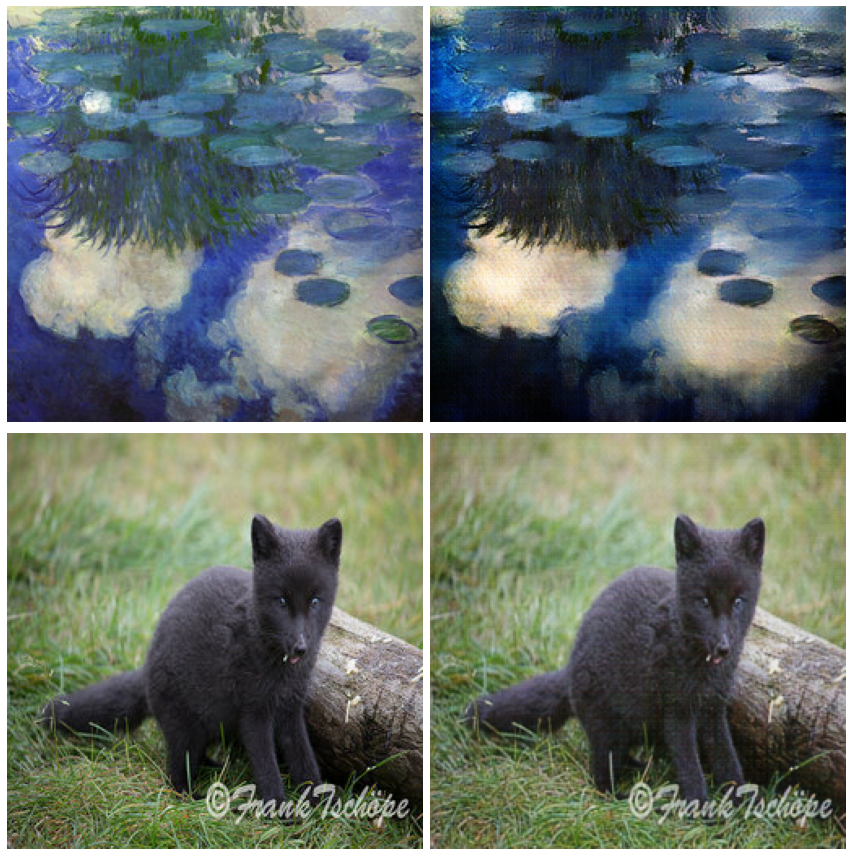

Time taken: 252.18338322639465
Epoch: 2
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


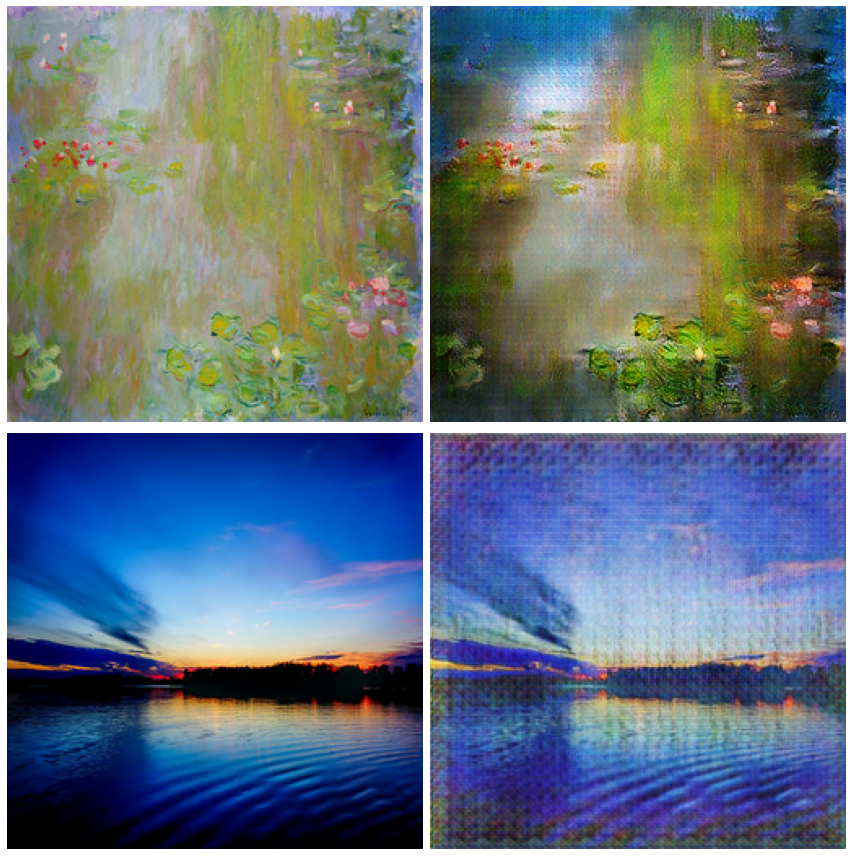

Time taken: 252.0154299736023
Epoch: 3
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


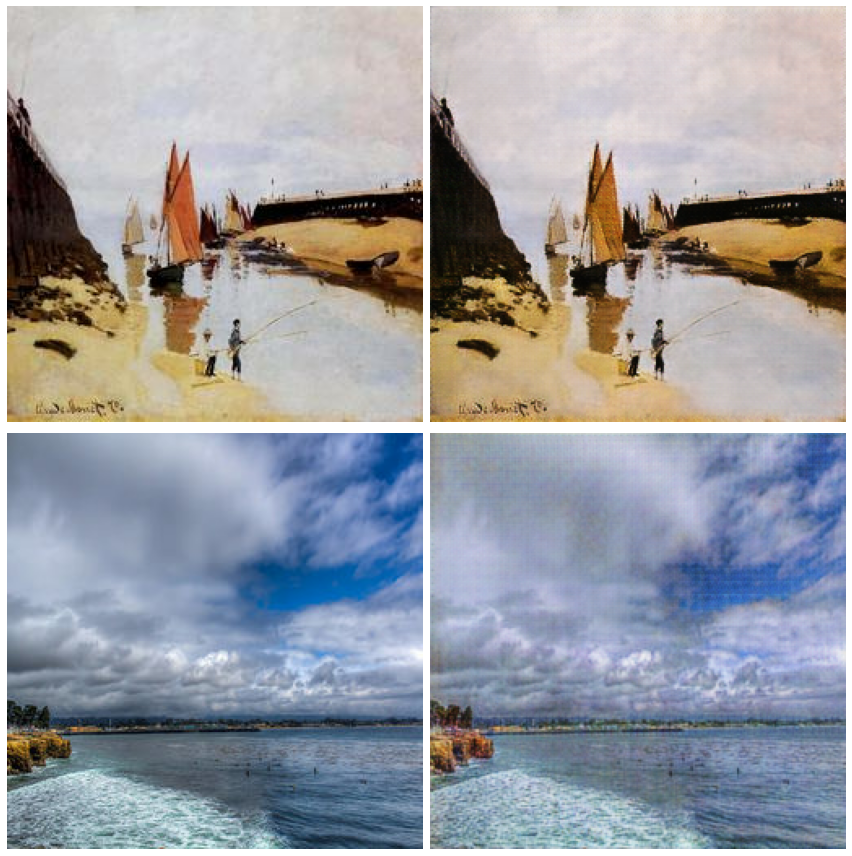

Time taken: 252.25724267959595
Epoch: 4
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


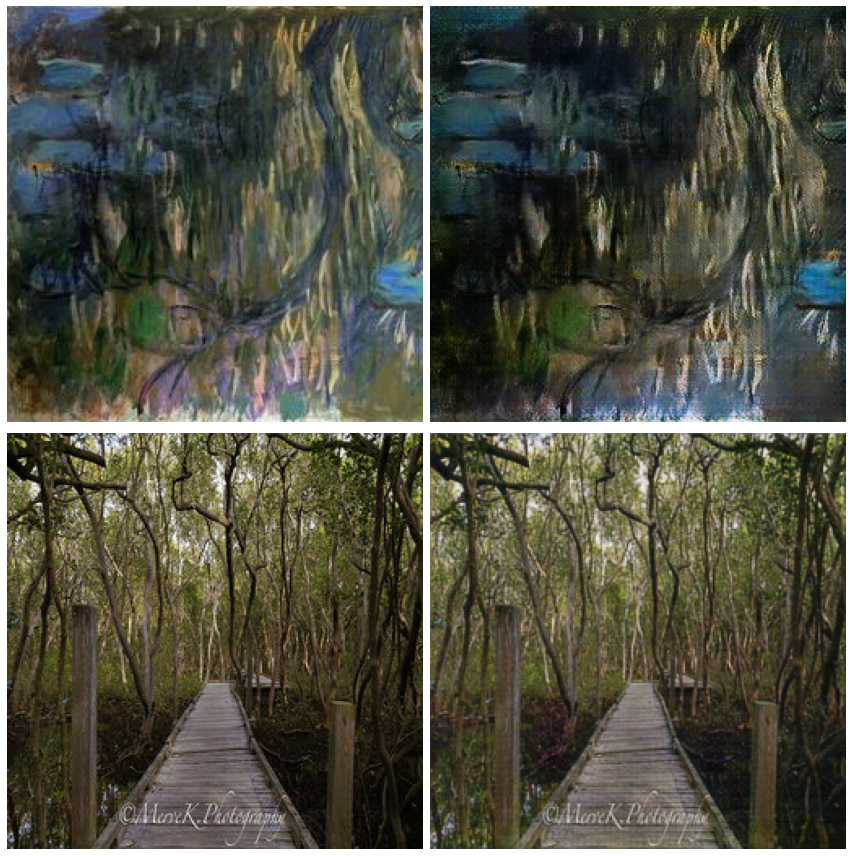

Time taken: 252.19289565086365
Epoch: 5
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


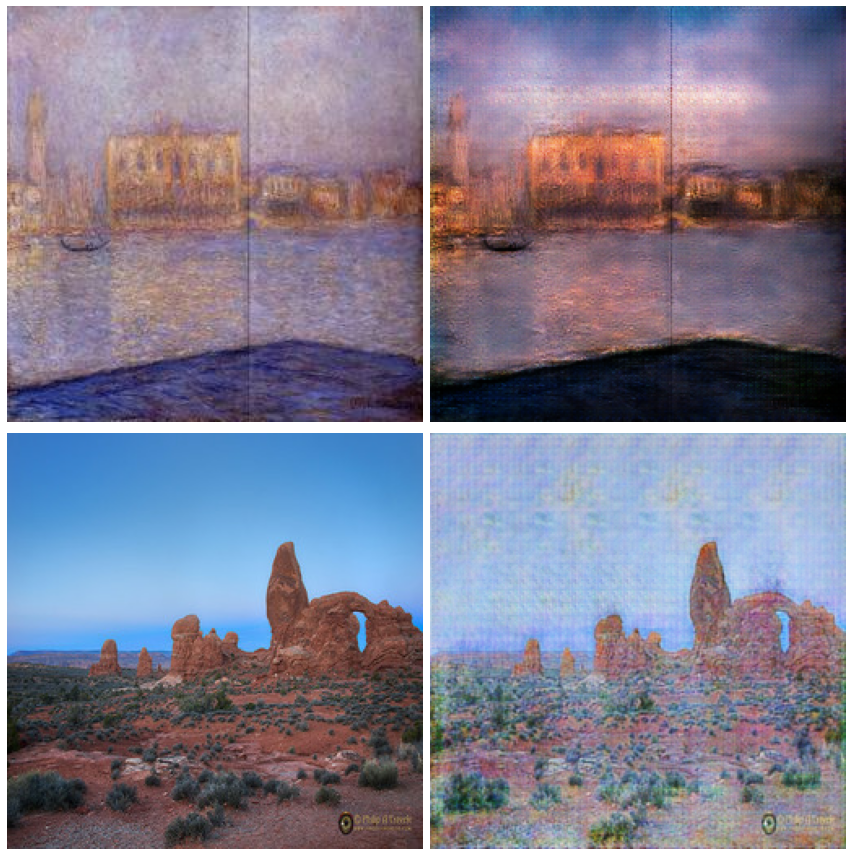

Time taken: 252.27308130264282
Epoch: 6
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


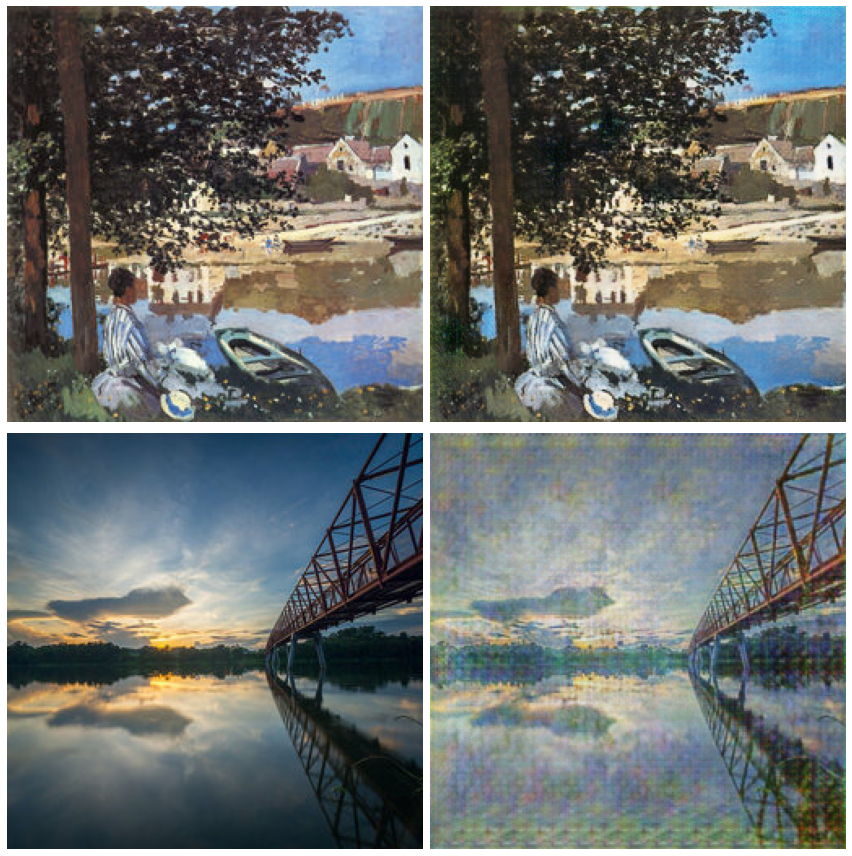

Time taken: 252.37788772583008
Epoch: 7
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


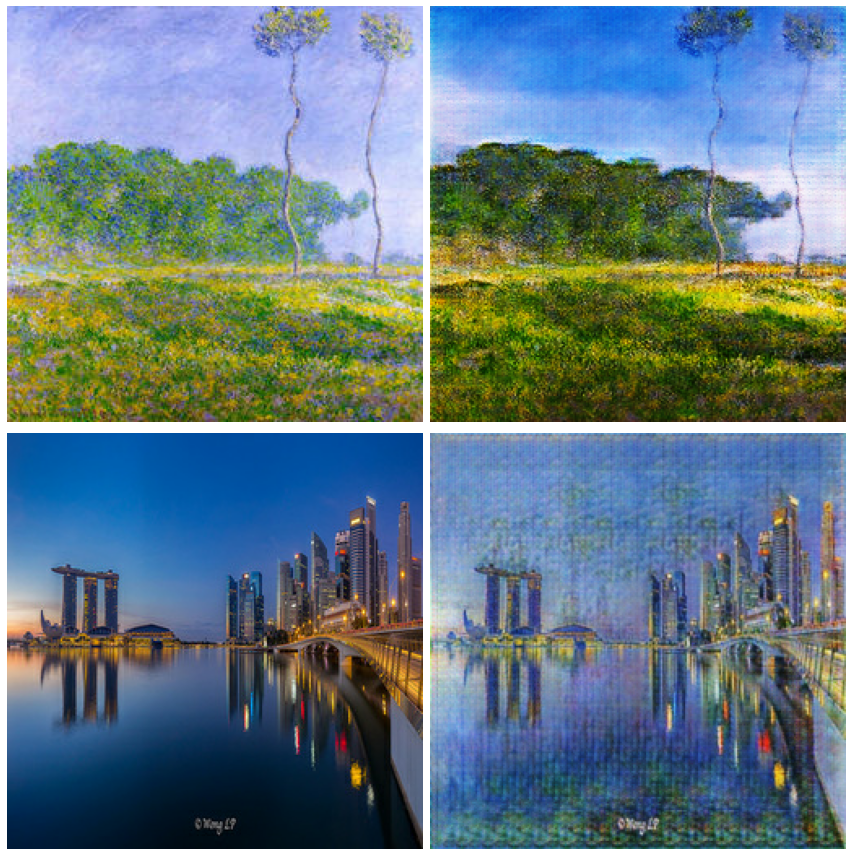

Time taken: 252.54600954055786
Epoch: 8
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


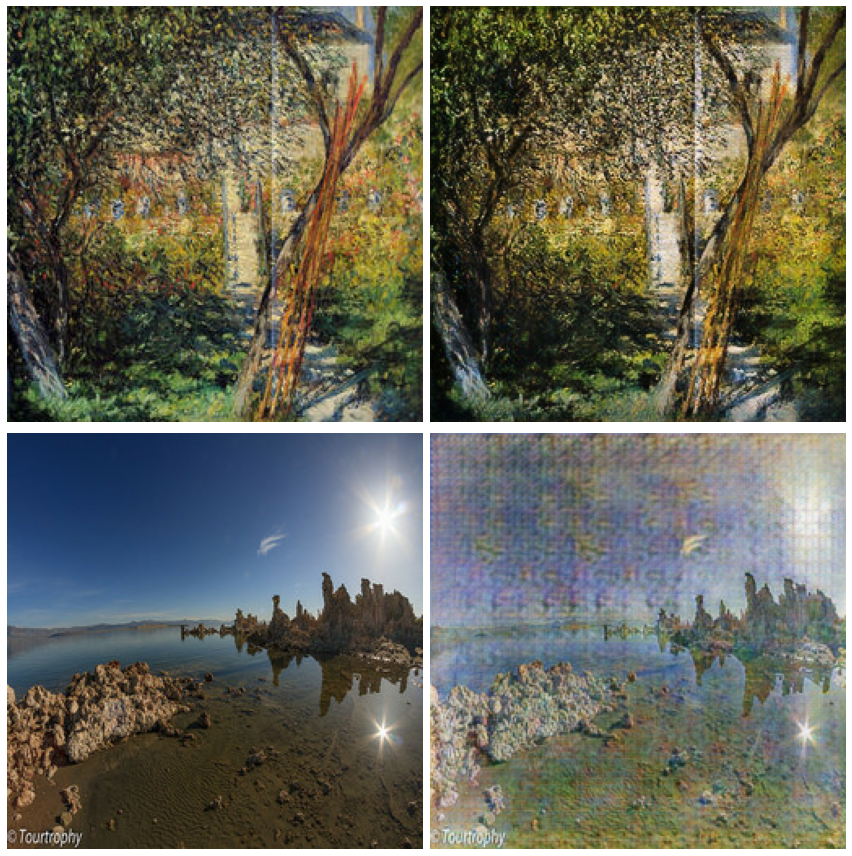

Time taken: 252.5659520626068
Epoch: 9
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


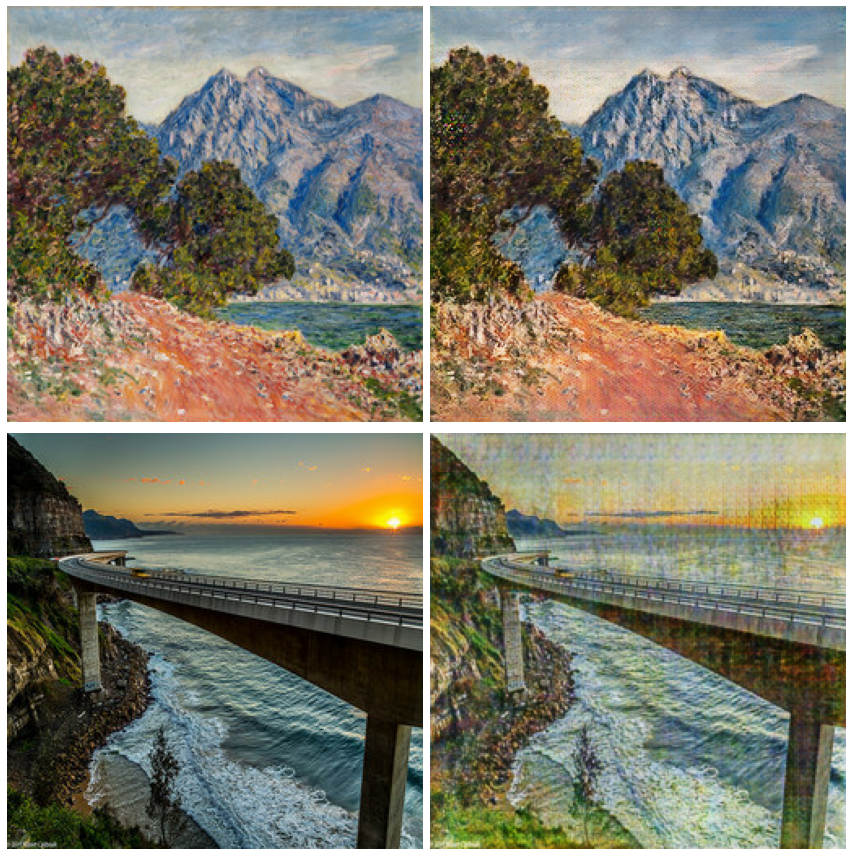

Time taken: 252.49362659454346
Epoch: 10
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


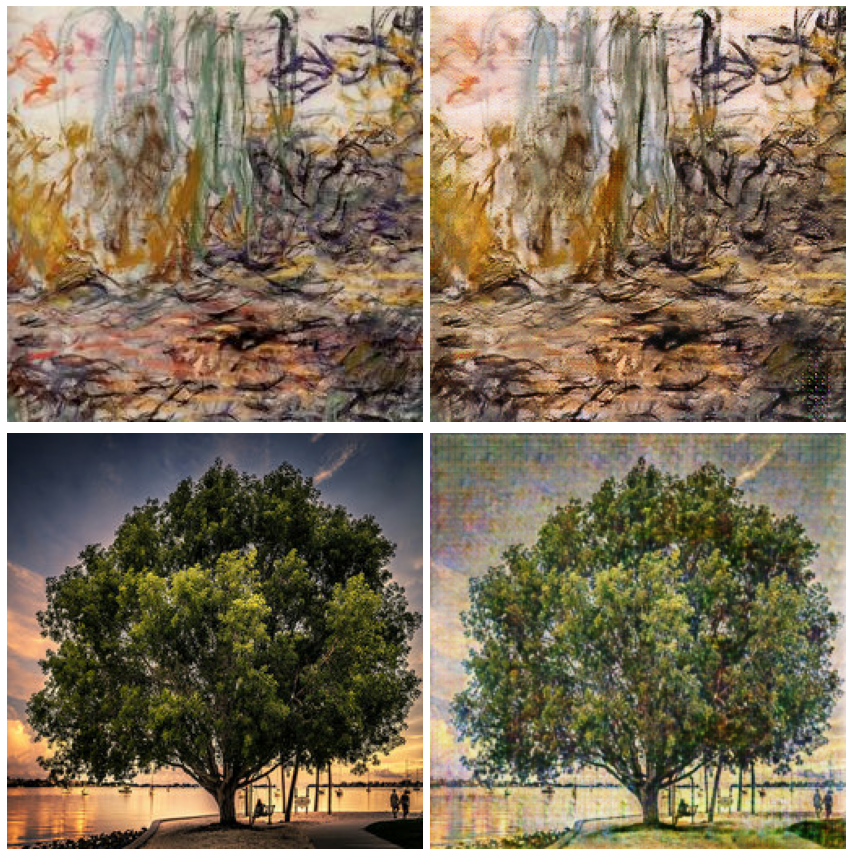

Time taken: 252.38139009475708
Epoch: 11
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


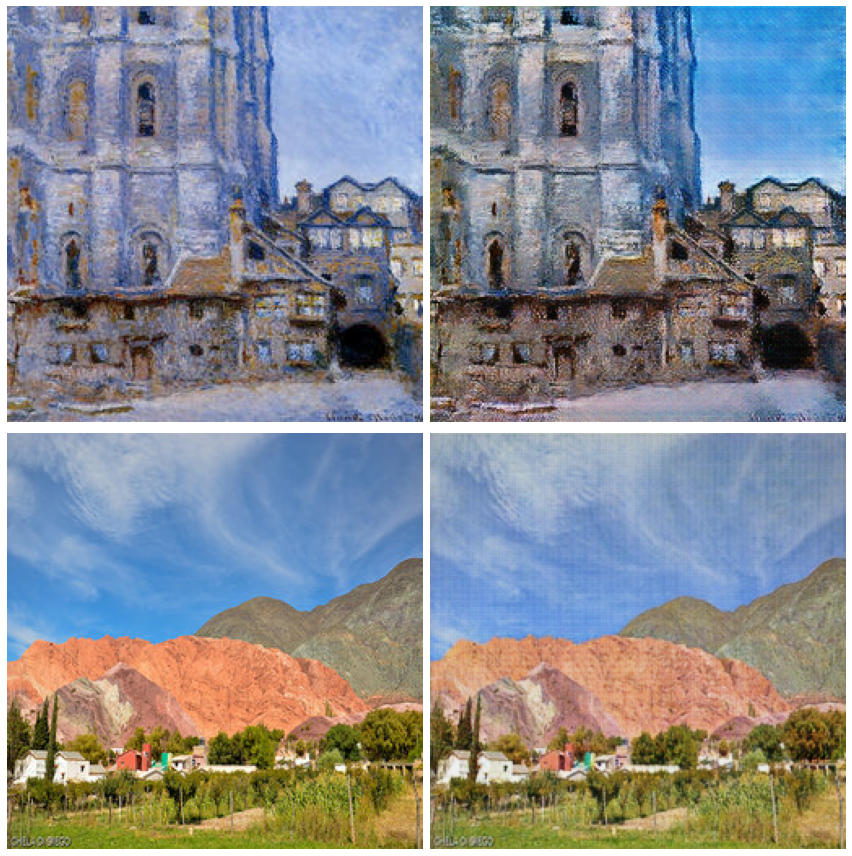

Time taken: 252.26246666908264
Epoch: 12
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


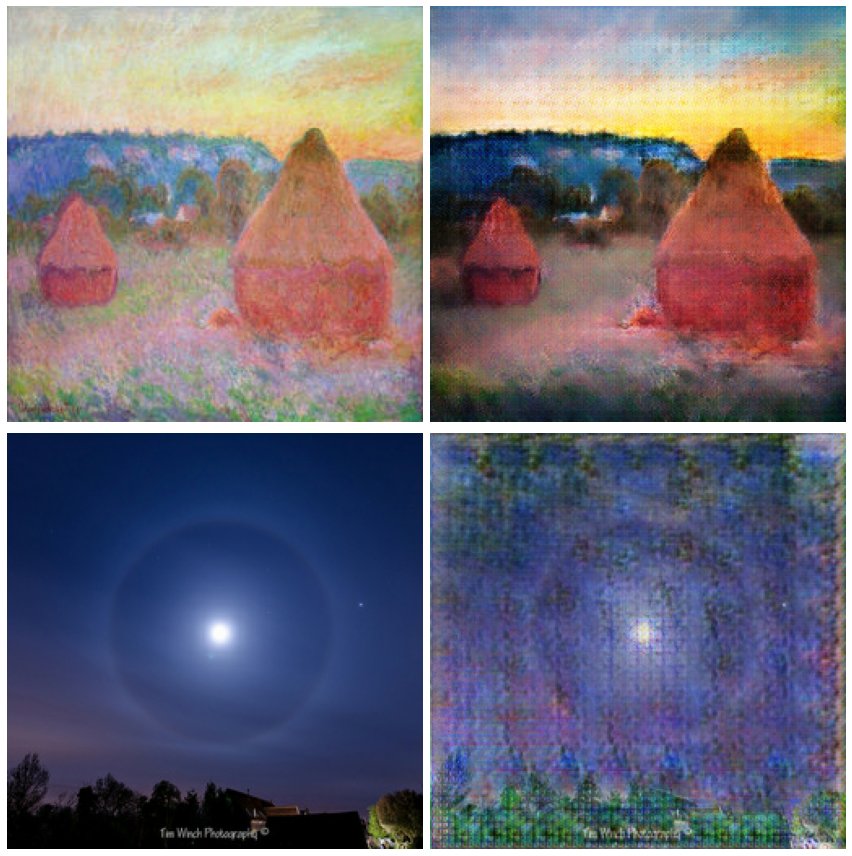

Time taken: 252.5487401485443
Epoch: 13
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


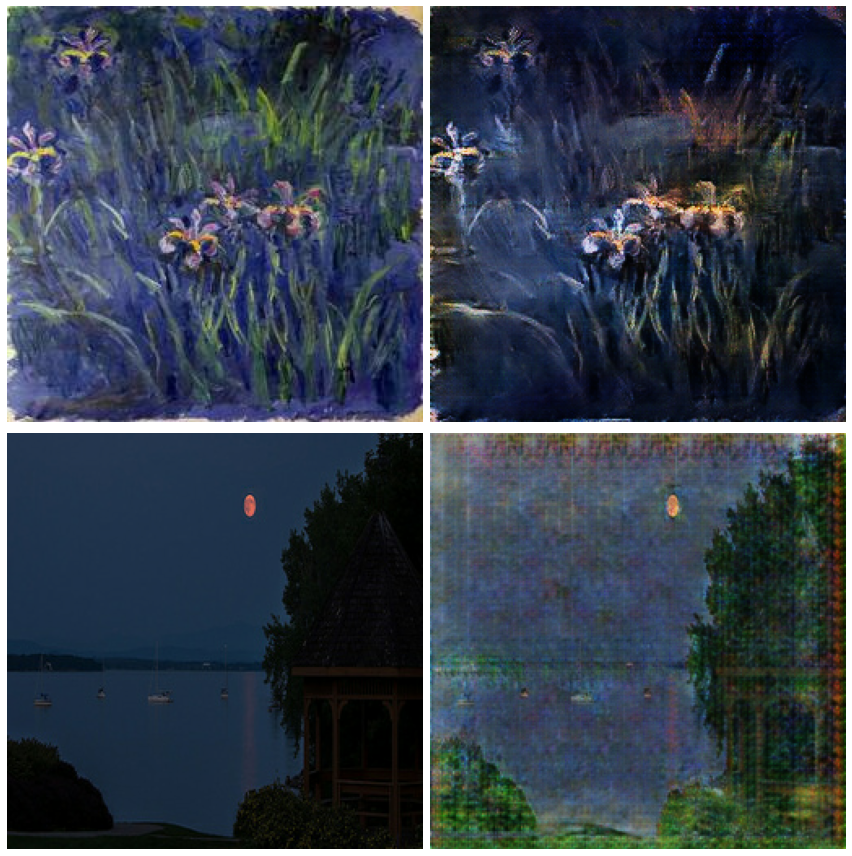

Time taken: 252.32751941680908
Epoch: 14
0
50
100
150
200
250
300
350
400
450
500
550
600
650
700
750
800
850
900
950
1000
1050


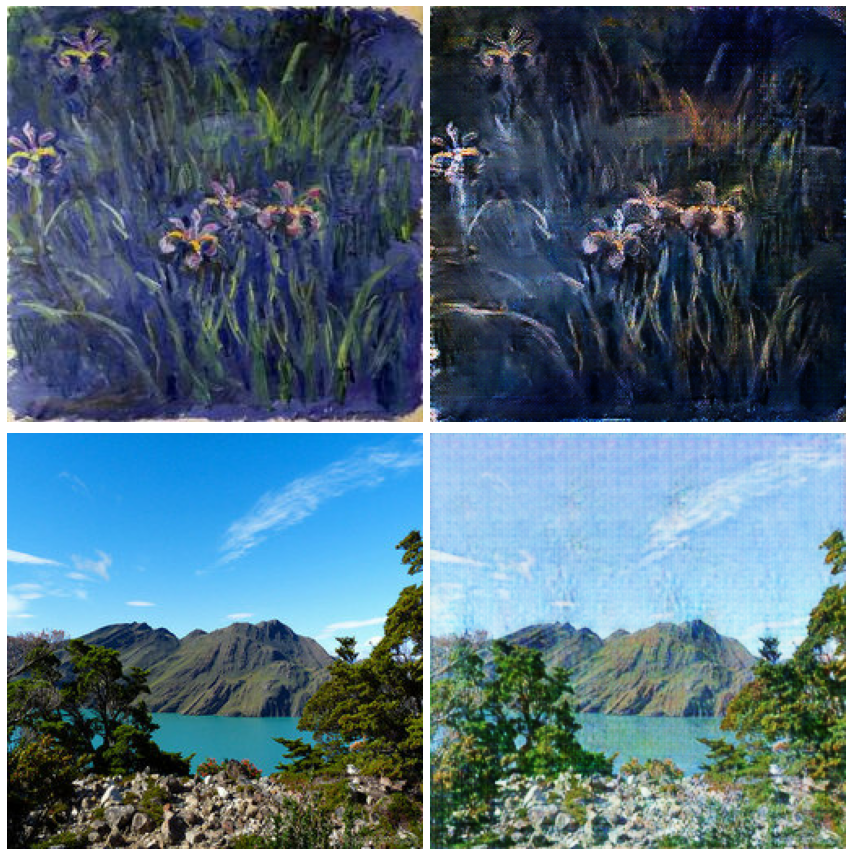

Time taken: 252.31194686889648
Epoch: 15
0
50
100
150
200
250
300


In [ ]:
import time
for epoch in range(20):
    print('Epoch: {}'.format(epoch))
    start = time.time()

    for k, (real_x, real_y) in enumerate(tf.data.Dataset.zip((train_x, train_y))):
        if k % 50 == 0: print(k)
        step(tf.reshape(real_x, (1, img_rows, img_cols, channels)), tf.reshape(real_y, (1, img_rows, img_cols, channels)))
    
    generate_images()
    print('Time taken: {}'.format(time.time() - start))

In [ ]:
generator_g.save_weights('gen_g.h5')
generator_f.save_weights('gen_f.h5')
discriminator_x.save_weights('dis_x.h5')
discriminator_y.save_weights('dis_y.h5')

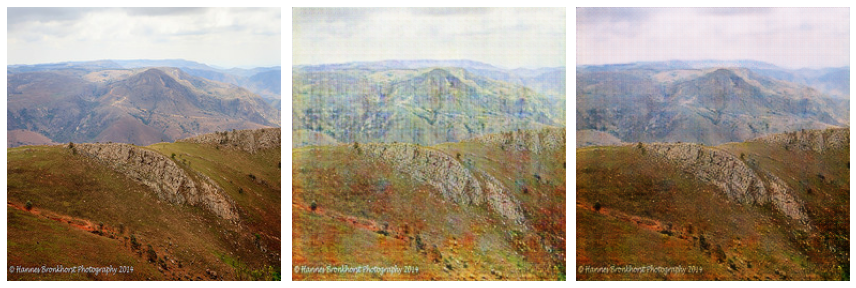

In [ ]:
x = next(iter(test_x.shuffle(1000))).numpy()
y = next(iter(test_y.shuffle(1000))).numpy()

x_hat = generator_f.predict(y.reshape((1, img_rows, img_cols, channels)))
y_hat = generator_g.predict(x_hat)

plt.figure(figsize=(12, 12))

images = [y[0], x_hat[0], y_hat[0]]

for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.imshow(images[i] * 0.5 + 0.5)
    plt.axis('off')
plt.tight_layout()
plt.show()